#### Example notebook to demonstrate usage of functions in biosynseq.metrics and biosynseq.visualize for the following purposes:
- Visualize embeddings for generated, test, or validation sequences using t-SNE and UMAP.
- Plot the embedding L2 distance against the pairwise global/local alignment scores for the embeddings.
- Plot the histogram distributions for each sequence metric.
- Plot the histogram distributions of mean, max, and min alignment scores between the alignment of two collections of sequences. <br>

These visualizations allow the user to evaluate the performance of a deep learning model in terms of learning important sequence properties and generating novel nucleotide sequences with relevant properties. 

In [45]:
from biosynseq import metrics
from biosynseq import visualize
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from Bio.Seq import Seq
from Bio.SeqRecord import SeqRecord
from pathlib import Path
import h5py
from collections import defaultdict, Counter
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
%config InlineBackend.figure_format='retina'
%matplotlib inline
plt.rcParams['figure.figsize'] = [8,6]
plt.rcParams["font.family"] = "sans-serif"
plt.rcParams.update({'font.size':14})

In [66]:
def get_gc(seq: np.ndarray) -> float:
    """Returns percentage GC content given sequence as a numpy array"""
    g_content = np.sum(seq == "G")
    c_content = np.sum(seq == "C")
    return (g_content + c_content) / len(seq)

def get_paint_df(dna_seqs):
    paint_df = pd.DataFrame(
        {
            "GC": metrics.gc_content(dna_seqs),
            "SequenceLength": metrics.seq_length(dna_seqs),
        }
    )
    return paint_df

def load_seqs(h5_path):
    with h5py.File(h5_path, "r") as f:
        seqs = f["sequence"][...]
        descriptions = f["description"][...]
        ids = f["id"][...]
        
    seqs = [
        SeqRecord(
            Seq(seq.decode("utf-8")),
            id=id_.decode("utf-8"),
            name=id_.decode("utf-8"),
            description=description.decode("utf-8"),
        ) 
        for seq, id_, description in zip(seqs, ids, descriptions)
    ]

    
    return seqs, descriptions, ids


def get_classes(descriptions):
    classes = defaultdict(list)
    for item in descriptions:
        fields = item.decode("utf-8").split("|")
        classes["strain"].append(fields[0])
        classes["variant"].append(fields[1])
        classes["region"].append(fields[2])
        classes["species"].append(fields[3])
        classes["variant-label"].append(fields[1].split(".")[0][0])
        classes["region-label"].append(fields[2].split(":")[0])
        classes["time"].append(fields[4])
        
    return pd.DataFrame(classes)

# 1. Get t-SNE plots

### SARS-CoV-2 Genomes sequences

In [9]:
val_embed_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/25m_genome_val_embeddings.npy")
val_h5_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/mcov_h5/MCoV-high-quality_no_ambig_or_gap_val.h5")

seqs, descriptions, ids = load_seqs(val_h5_path)
embed_avg = np.load(val_embed_path)

In [5]:
embed_avg.shape

(3392, 512)

In [11]:
labels = get_paint_df(seqs)

{'GC':             z0         z1         GC
 0     3.481649  -7.883403  37.994670
 1     9.733963  -2.174672  38.011973
 2     8.290599   7.420684  37.983607
 3     0.742282  -3.760906  38.004686
 4    -0.597793  -5.387051  37.936390
 ...        ...        ...        ...
 3387  3.571535  -8.067660  37.987583
 3388 -8.742567  14.906260  37.959335
 3389  4.339467  -8.707918  37.957240
 3390  8.947654   7.446512  37.970115
 3391 -0.104998  -2.374691  38.031282
 
 [3392 rows x 3 columns],
 'SequenceLength':             z0         z1  SequenceLength
 0     3.481649  -7.883403           29641
 1     9.733963  -2.174672           29567
 2     8.290599   7.420684           29647
 3     0.742282  -3.760906           29449
 4    -0.597793  -5.387051           29618
 ...        ...        ...             ...
 3387  3.571535  -8.067660           29636
 3388 -8.742567  14.906260           29608
 3389  4.339467  -8.707918           29607
 3390  8.947654   7.446512           29647
 3391 -0.104998  -2

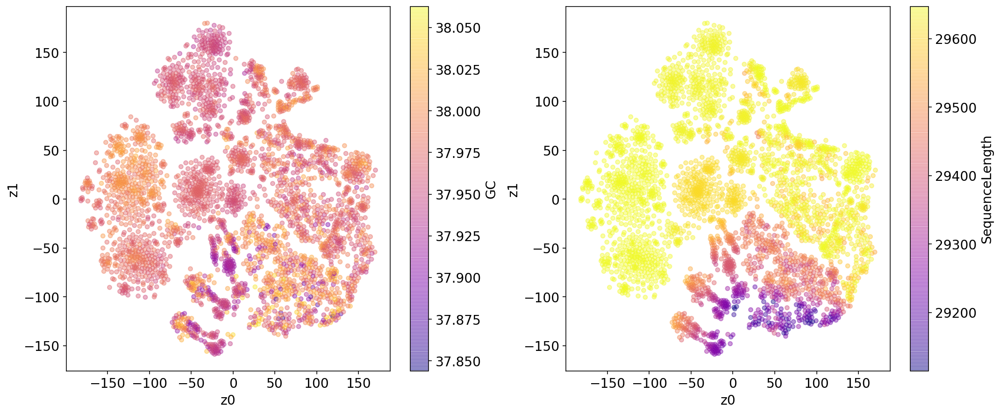

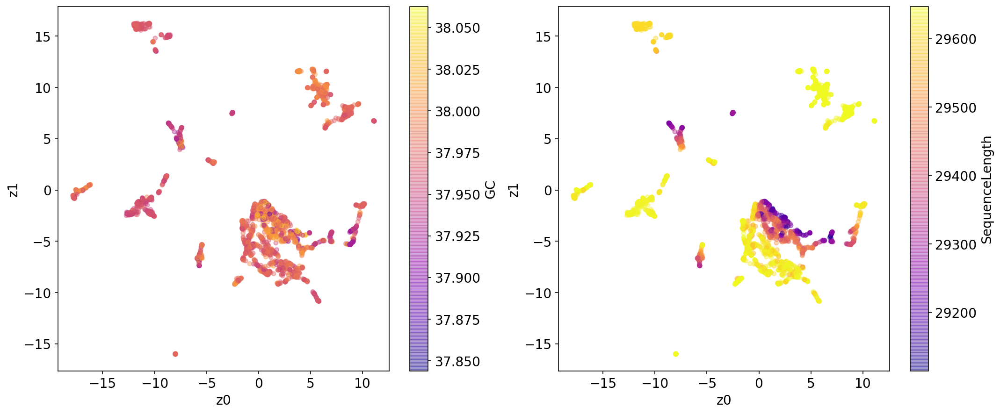

In [13]:
# if getting all plots as subplots of a collective image, add the argument get_subplots=True
df = visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="tsne", get_subplots=True)
visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="umap", get_subplots=True)

# Train sequences

In [17]:
train_embed_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/25m_genome_train_embeddings.npy")
train_h5_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/mcov_h5/MCoV-high-quality_no_ambig_or_gap_train.h5")

seqs, descriptions, ids = load_seqs(train_h5_path)
embed_avg = np.load(train_embed_path)

[W] [20:26:16.261612] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...


{'GC':              z0         z1         GC
 0     -3.312816   5.633548  37.995441
 1      5.526481  -7.166380  37.976861
 2     -3.637028   0.023565  38.009295
 3      8.469433  -2.464526  37.946624
 4     -4.809366  -4.562138  37.958797
 ...         ...        ...        ...
 27133  4.704525  -8.194751  37.990353
 27134 -8.129245 -10.956470  37.939286
 27135 -0.909648   4.774296  37.980364
 27136  7.926950  -3.590291  37.970242
 27137 -4.506685   3.219535  37.974812
 
 [27138 rows x 3 columns],
 'SequenceLength':              z0         z1  SequenceLength
 0     -3.312816   5.633548           29393
 1      5.526481  -7.166380           29647
 2     -3.637028   0.023565           29477
 3      8.469433  -2.464526           29639
 4     -4.809366  -4.562138           29561
 ...         ...        ...             ...
 27133  4.704525  -8.194751           29647
 27134 -8.129245 -10.956470           29252
 27135 -0.909648   4.774296           29639
 27136  7.926950  -3.590291           2

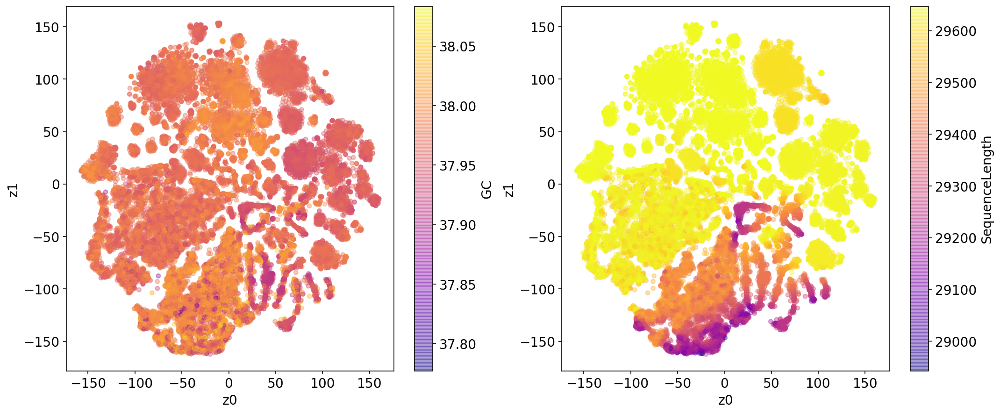

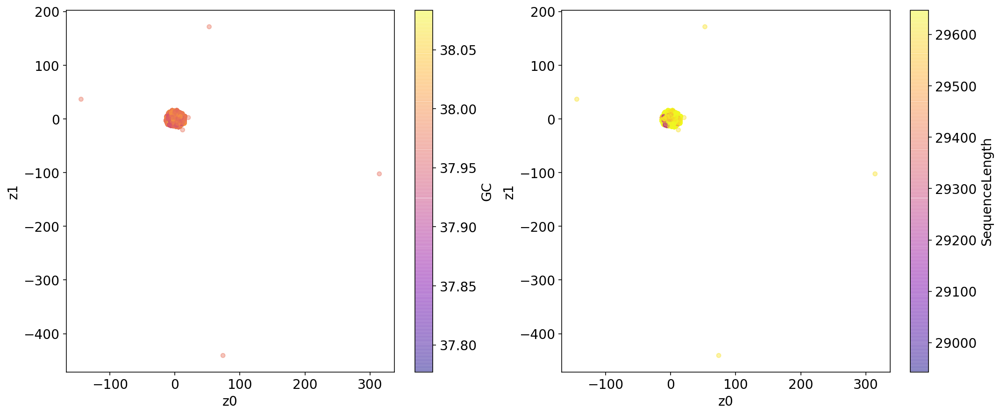

In [18]:
labels = get_paint_df(seqs)
# if getting all plots as subplots of a collective image, add the argument get_subplots=True
df = visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="tsne", get_subplots=True)
visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="umap", get_subplots=True)

# Raw Train Embeddings


In [154]:
from mdlearn.visualize import plot_scatter

In [23]:
plot_scatter(embed_avg[:, 0:0+3], {"SequenceLength": labels.SequenceLength}, "SequenceLength")

# Smalll 1000 Subset of the 1.5M COVID Genomes

In [25]:
val_embed_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/validaion_1000seq_subsample.npy")
val_h5_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/validation_1000seq_subsample.h5")

seqs, descriptions, ids = load_seqs(val_h5_path)
embed_avg = np.load(val_embed_path)

In [29]:
classes = get_classes(descriptions)
classes

,strain,variant,region,species,variant-label,region-label,time
0,OK441256.1,AY.25,USA: Massachusetts,Homo sapiens,AY,USA,2021-09-30
1,OU207376.1,B.1.1.7,Pakistan,Homo sapiens,B,Pakistan,2021-04-09
2,OK578537.1,AY.44,USA: Texas,Homo sapiens,AY,USA,2021-09-08
3,OM894658.1,BA.1.1,USA: Connecticut,Homo sapiens,BA,USA,2022-02-13
4,MZ412411.1,B.1.637,USA: North Carolina,Homo sapiens,B,USA,2021-06-06
...,...,...,...,...,...,...,...
995,OM007305.1,AY.117,USA: Connecticut,Homo sapiens,AY,USA,2021-12-05
996,MZ942084.1,AY.3,USA: West Virginia,Homo sapiens,AY,USA,2021-07-17
997,OK039779.1,AY.44,USA,Homo sapiens,AY,USA,2021-07-15
998,MT972065.1,D.2,Australia: Victoria,Homo sapiens,D,Australia,2020-07-23


In [32]:
Counter(classes["region-label"])

Counter({'USA': 813,
         'Pakistan': 1,
         'United Kingdom': 11,
         'Denmark': 8,
         'Switzerland': 26,
         'Netherlands': 2,
         'Germany': 100,
         'China': 1,
         'Bangladesh': 1,
         'France': 9,
         'Chile': 1,
         'Australia': 7,
         'Mongolia': 1,
         'India': 2,
         'Hong Kong': 2,
         'New Zealand': 1,
         'Slovakia': 4,
         'Poland': 1,
         'Mexico': 1,
         'South Africa': 1,
         'Nigeria': 1,
         'Italy': 1,
         'Japan': 1,
         'Egypt': 2,
         'Saudi Arabia': 1,
         'Spain': 1})

In [33]:
Counter(classes["variant-label"])

Counter({'AY': 502,
         'B': 284,
         'BA': 189,
         'R': 1,
         'D': 7,
         'P': 9,
         'Q': 3,
         'A': 3,
         'XB': 1,
         'C': 1})

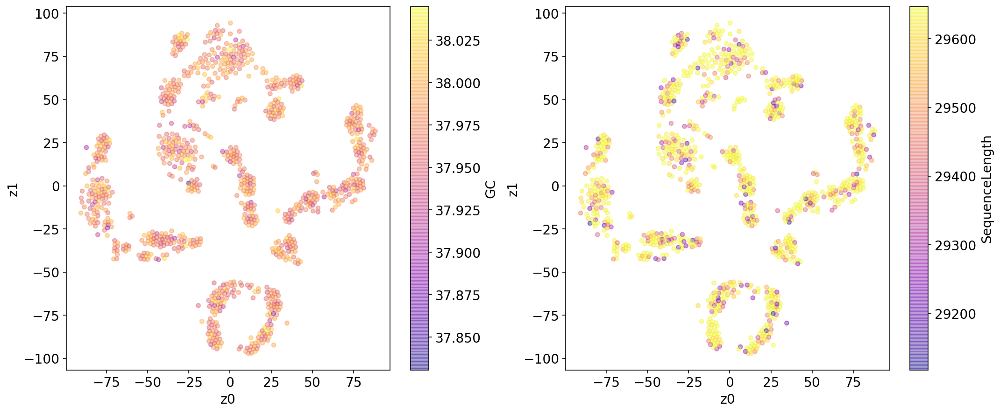

In [34]:
df = visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="tsne", get_subplots=True)

In [40]:
df

{'GC':             z0         z1         GC
 0   -80.002754  17.240473  37.995441
 1     9.099309  49.705746  37.976861
 2    -2.176176  72.690872  38.009295
 3    27.185907 -66.966782  37.946624
 4   -29.885872   3.654740  37.958797
 ..         ...        ...        ...
 995 -34.265762  61.469509  37.956504
 996 -70.592430 -42.407009  37.997149
 997 -31.027042  61.220119  37.998381
 998  20.654051 -85.400459  37.977589
 999 -76.457161 -10.053875  37.960120
 
 [1000 rows x 3 columns],
 'SequenceLength':             z0         z1  SequenceLength
 0   -80.002754  17.240473           29393
 1     9.099309  49.705746           29647
 2    -2.176176  72.690872           29477
 3    27.185907 -66.966782           29639
 4   -29.885872   3.654740           29561
 ..         ...        ...             ...
 995 -34.265762  61.469509           29244
 996 -70.592430 -42.407009           29468
 997 -31.027042  61.220119           29646
 998  20.654051 -85.400459           29628
 999 -76.457161 -10

In [43]:
varient_enc = LabelEncoder()
region_enc = LabelEncoder()

plot_df = pd.DataFrame({
    "z0": df["GC"]["z0"],
    "z1": df["GC"]["z1"],
    "real-variant-label": classes["variant-label"],
    "real-region-label": classes["region-label"],
    "variant-label": varient_enc.fit_transform(classes["variant-label"]),
    "region-label": region_enc.fit_transform(classes["region-label"])
}).sort_values(by=['real-variant-label'])

plot_df

,z0,z1,real-variant-label,real-region-label,variant-label,region-label
977,24.965578,-80.469872,A,USA,0,24
764,60.361099,-0.849313,A,Spain,0,22
577,13.326345,-91.371971,A,USA,0,24
556,-85.821289,8.262683,AY,USA,1,24
558,-16.022758,57.779156,AY,USA,1,24
...,...,...,...,...,...,...
540,77.186798,39.431210,Q,USA,7,24
352,-4.059212,-57.382069,Q,USA,7,24
357,29.536800,-36.341053,Q,USA,7,24
93,5.770207,5.894365,R,USA,8,24


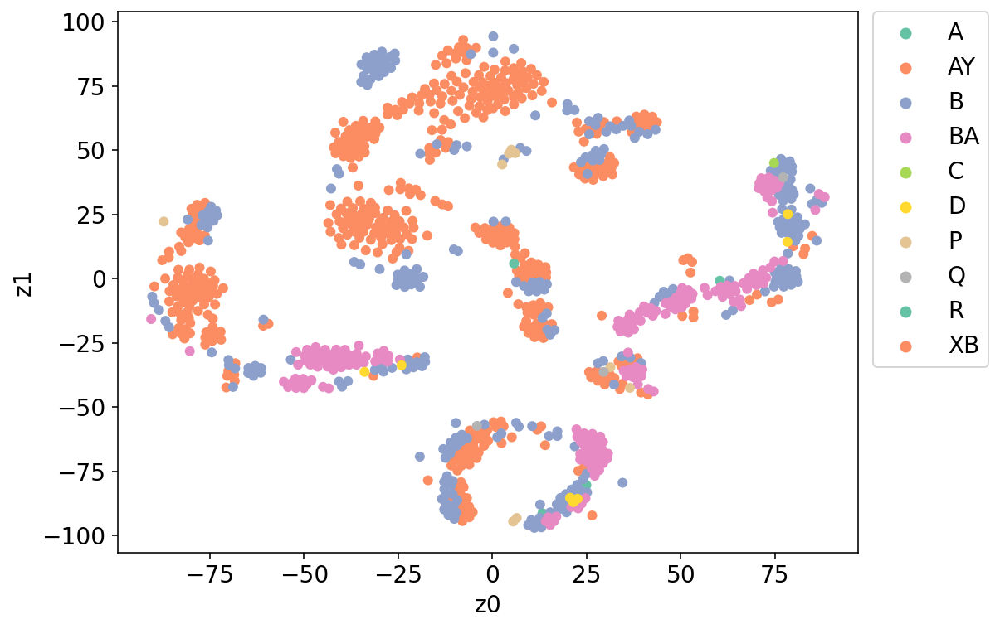

In [47]:
ax = sns.scatterplot(x='z0', y='z1', data=plot_df, hue="real-variant-label", palette="Set2", ec=None)
ax.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.show()

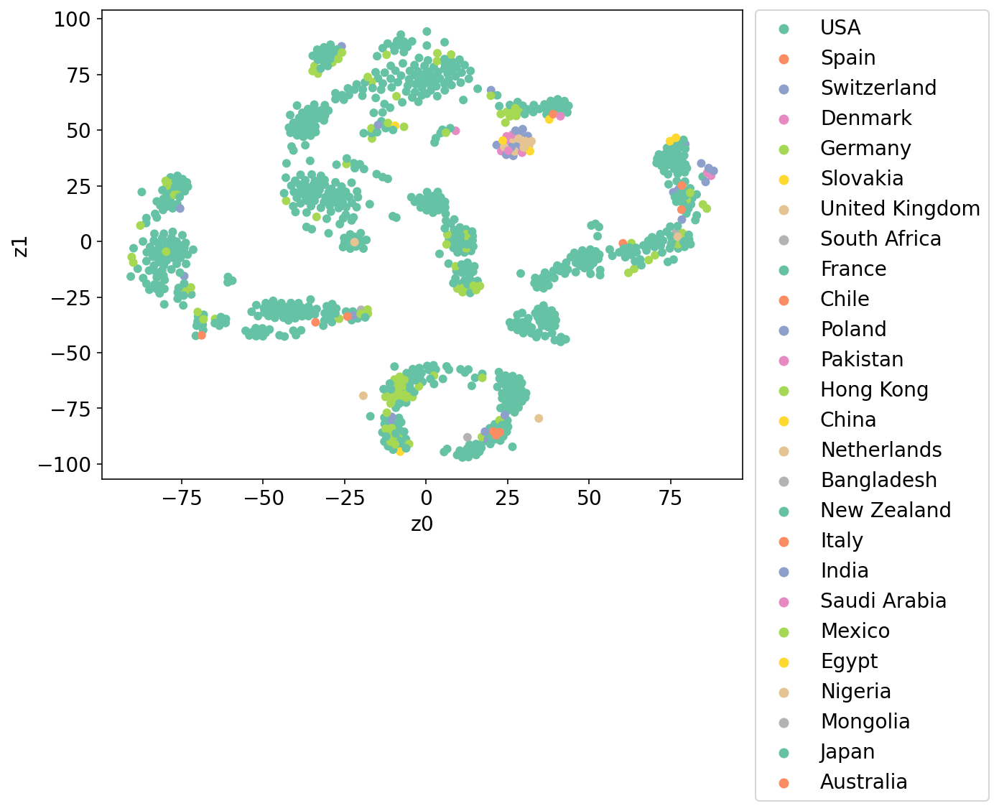

In [48]:
ax = sns.scatterplot(x='z0', y='z1', data=plot_df, hue="real-region-label", palette="Set2", ec=None)
ax.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.show()

In [67]:
val_embed_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/sarscov2_filtered-50k-subsample.npy")
val_h5_path = Path("/lambda_stor/data/khippe/25m_genome_embeddings/sarscov2_filtered-50k-subsample.h5")

seqs, descriptions, ids = load_seqs(val_h5_path)
embed_avg = np.load(val_embed_path)

classes = get_classes(descriptions)
classes

,strain,variant,region,species,variant-label,region-label,time
0,NC_045512.2,B,China,Homo sapiens,B,China,2019-12
1,ON338717.1,AY.44,USA,Homo sapiens,A,USA,2021-12-01
2,ON338749.1,AY.103,USA,Homo sapiens,A,USA,2021-12-01
3,ON338790.1,AY.103,USA,Homo sapiens,A,USA,2021-12-01
4,ON338830.1,AY.44,USA,Homo sapiens,A,USA,2021-11-30
...,...,...,...,...,...,...,...
52488,MT246470.1,B.1.1,USA: WA,Homo sapiens,B,USA,2020-03-13
52489,MT192773.1,B,Viet Nam: Ho Chi Minh city,Homo sapiens,B,Viet Nam,2020-01-22
52490,MT159716.2,B,USA,Homo sapiens,B,USA,2020-02-24
52491,MT066176.1,B,Taiwan,Homo sapiens,B,Taiwan,2020-02-05


In [68]:
Counter(classes["region-label"])

Counter({'China': 15,
         'USA': 42183,
         'South Africa': 41,
         'France': 405,
         'Japan': 133,
         'United Kingdom': 496,
         'Brazil': 8,
         'Switzerland': 1876,
         'Thailand': 5,
         'Bahrain': 126,
         'Kenya': 8,
         'Peru': 9,
         'India': 58,
         'Djibouti': 17,
         'Malawi': 3,
         'Puerto Rico': 16,
         'Slovakia': 207,
         'Bangladesh': 34,
         'Paraguay': 8,
         'Jamaica': 12,
         'Dominican Republic': 12,
         'Mongolia': 19,
         'Uganda': 1,
         'Italy': 24,
         'Denmark': 472,
         'Gabon': 3,
         'Finland': 2,
         'Chile': 15,
         'Romania': 2,
         'Canada': 1,
         'Hong Kong': 55,
         'Germany': 5391,
         'Austria': 12,
         'Pakistan': 16,
         'Malaysia': 3,
         'South Korea': 2,
         'Ethiopia': 1,
         'Myanmar': 3,
         'Comoros': 1,
         'Saudi Arabia': 25,
         'Liecht

In [69]:
Counter(classes["variant-label"])

Counter({'B': 24990,
         'A': 26417,
         'U': 18,
         'X': 34,
         'Q': 158,
         'P': 435,
         'C': 84,
         'R': 45,
         'L': 2,
         'W': 2,
         'N': 5,
         'D': 303})

In [55]:
labels = get_paint_df(seqs)

[W] [22:15:13.188331] # of Nearest Neighbors should be at least 3 * perplexity. Your results might be a bit strange...


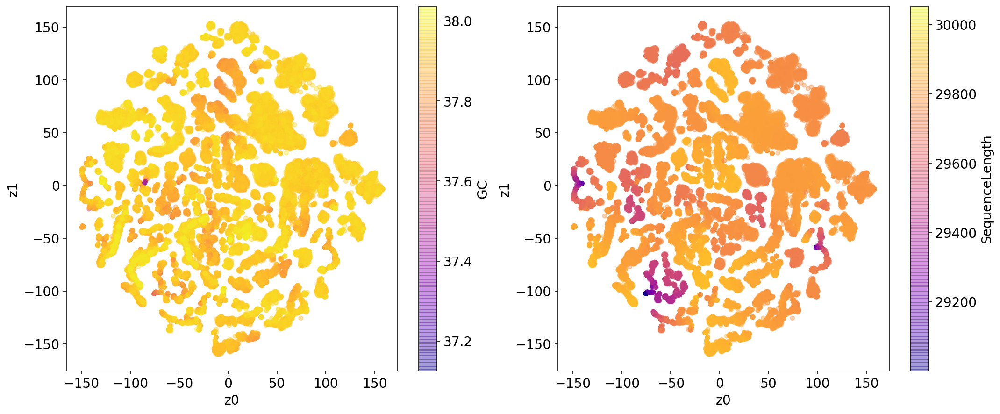

In [56]:
df = visualize.get_cluster(embed_data=embed_avg, paint_df=labels, tsne_umap="tsne", get_subplots=True)

In [70]:
varient_enc = LabelEncoder()
region_enc = LabelEncoder()

plot_df = pd.DataFrame({
    "z0": df["GC"]["z0"],
    "z1": df["GC"]["z1"],
    "real-variant-label": classes["variant-label"],
    "real-region-label": classes["region-label"],
    "variant-label": varient_enc.fit_transform(classes["variant-label"]),
    "region-label": region_enc.fit_transform(classes["region-label"])
}).sort_values(by=['real-variant-label'])

plot_df

,z0,z1,real-variant-label,real-region-label,variant-label,region-label
26246,9.255656,-2.925905,A,USA,0,72
25651,129.966293,3.646523,A,USA,0,72
25652,-19.923512,55.760563,A,USA,0,72
25653,125.246094,10.426472,A,USA,0,72
25654,29.692822,54.768250,A,USA,0,72
...,...,...,...,...,...,...
9311,-8.278065,-112.452507,X,USA,11,72
35717,-55.074665,-125.916519,X,USA,11,72
39357,-54.536236,-126.054405,X,USA,11,72
33660,94.777519,-42.467140,X,USA,11,72


In [152]:
my_palettes = ['Spectral_r', 'inferno_r', 'cool', 'gist_ncar', 'mako_r', 'plasma_r']

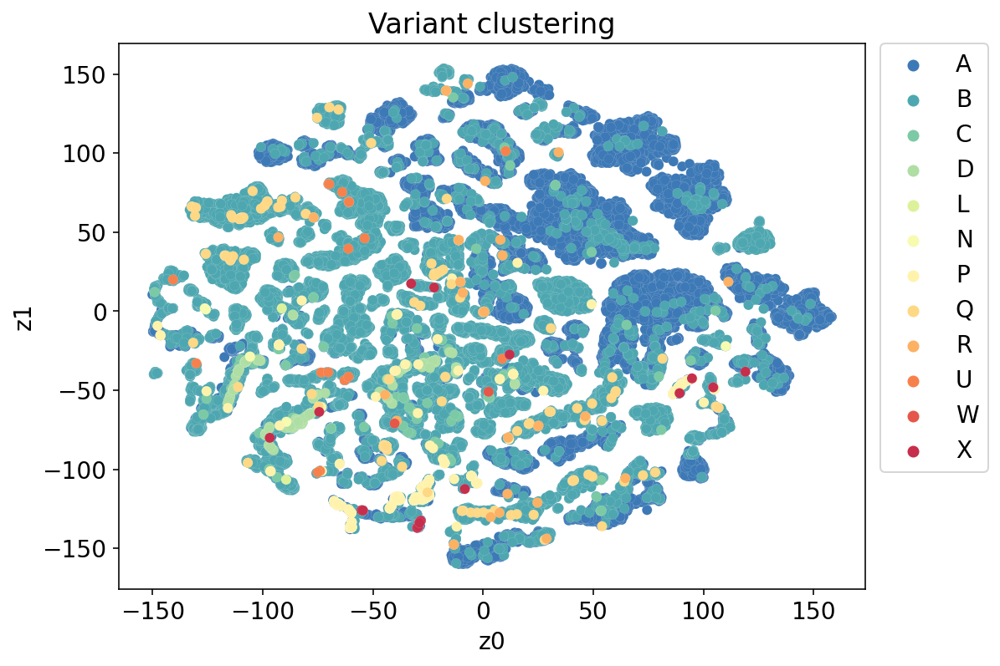

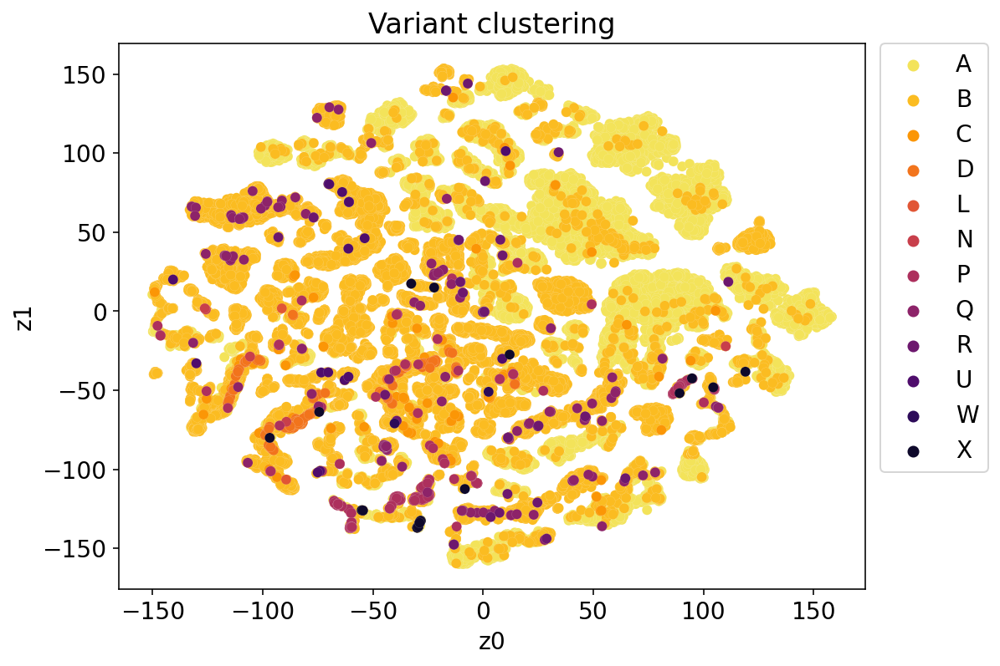

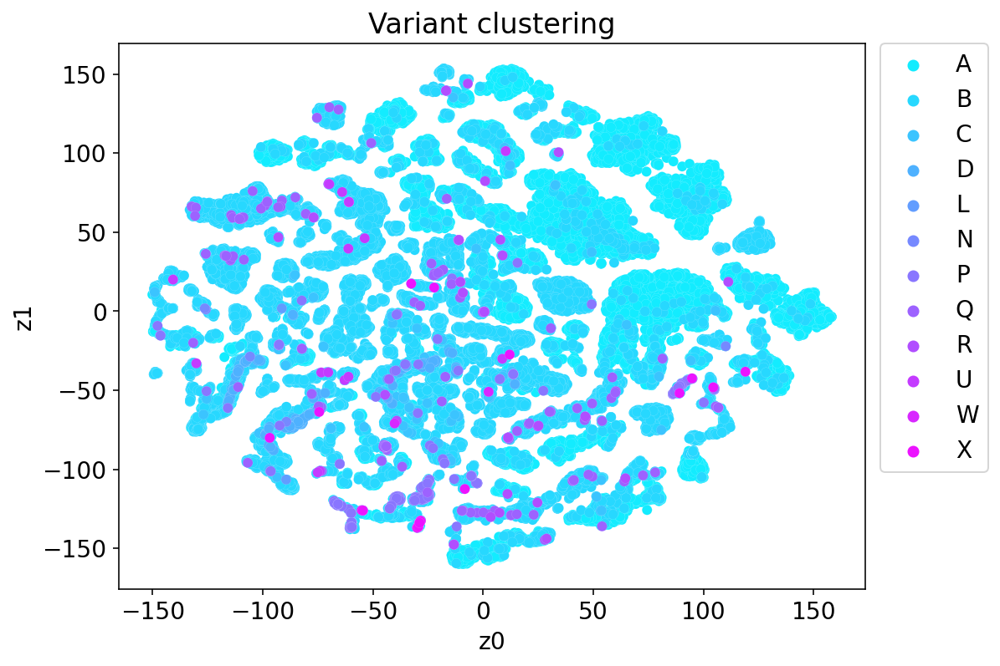

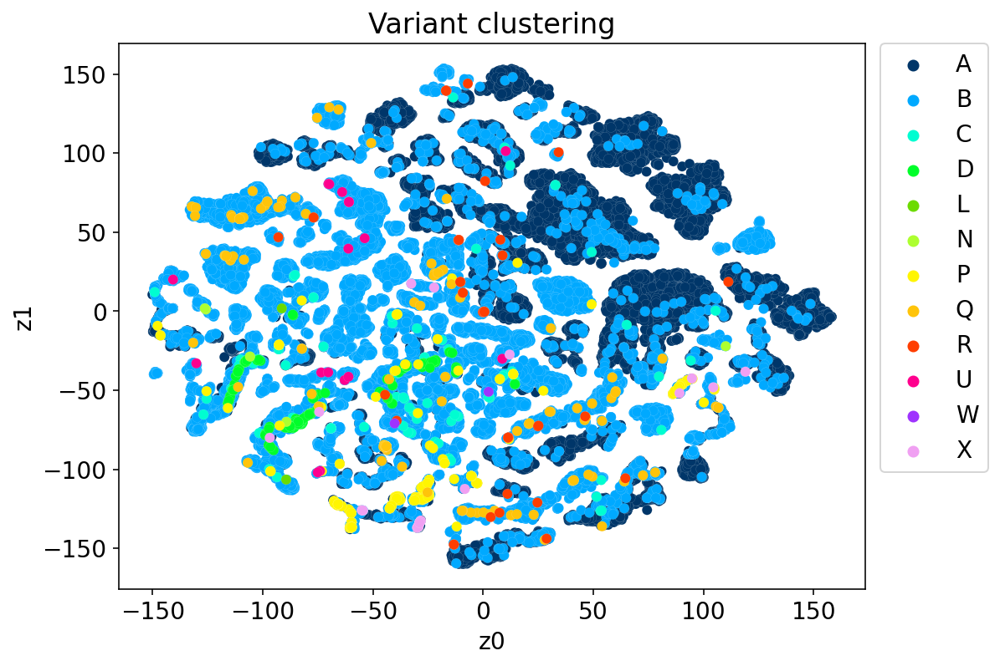

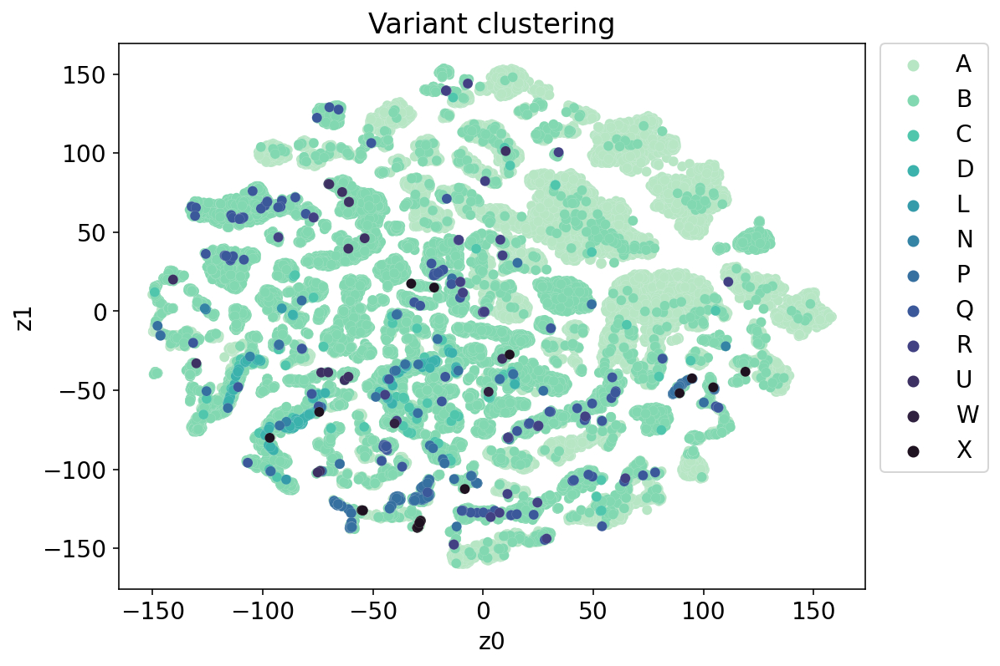

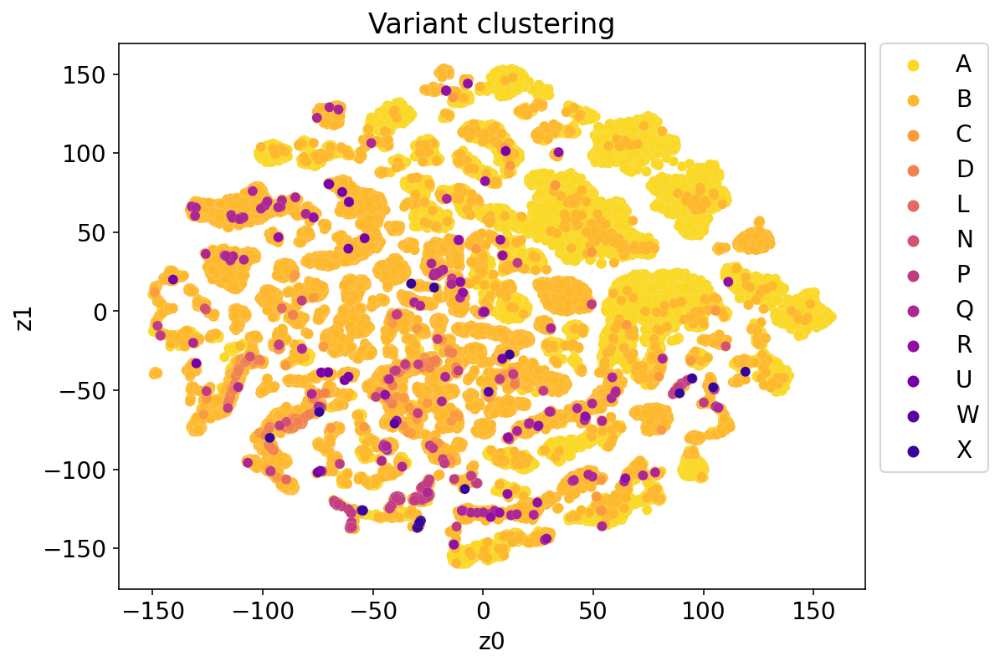

In [153]:
# "RdBu_r"
for p in my_palettes:
    #palatte = sns.color_palette(palette="hls", n_colors=len(np.unique(plot_df["variant-label"])))
    ax = sns.scatterplot(x='z0', y='z1', data=plot_df, hue="real-variant-label", palette=p, linewidth=0.05) # mako_r  ec=None
    ax.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0)
    plt.title("Variant clustering")
    plt.show()

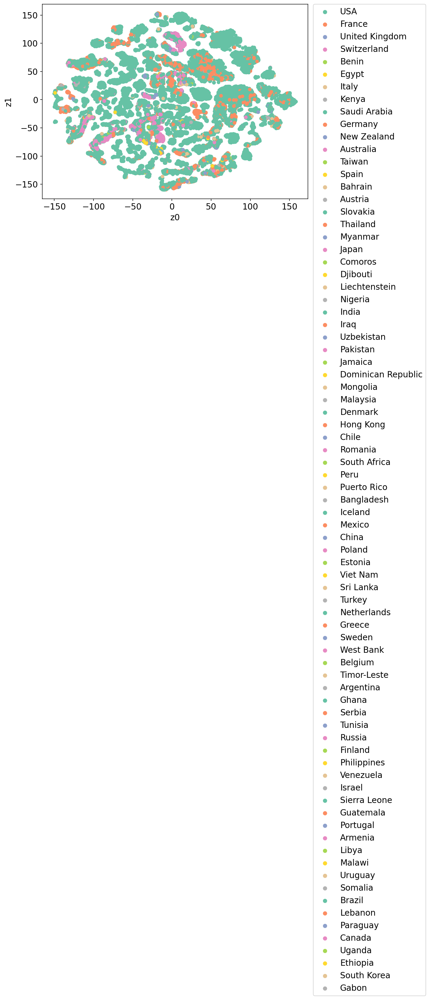

In [59]:
ax = sns.scatterplot(x='z0', y='z1', data=plot_df, hue="real-region-label", palette="Set2", ec=None)
ax.legend(bbox_to_anchor=(1.02, 1), borderaxespad=0)
plt.show()

In [156]:
plot_scatter(embed_avg[:, 20:20+3], {"Variant": plot_df["variant-label"]}, "Variant")